In [1]:
from google.colab import drive
drive.mount._DEBUG = True
drive.mount('/content/drive', force_remount=True)

unset HISTFILE; export PS1="root@f01f86f1a263-182bd8c7950c4fc7852e31c0885e0b9b: "
bash: cannot set terminal process group (-1): Inappropriate ioctl for device
bash: no job control in this shell
/content# root@f01f86f1a263-182bd8c7950c4fc7852e31c0885e0b9b: umount -f /content/drive || umount /content/drive; pkill -9 -x drive
umount: /content/drive: no mount point specified.
umount: /content/drive: no mount point specified.
root@f01f86f1a263-182bd8c7950c4fc7852e31c0885e0b9b: pkill -9 -f /opt/google/drive/directoryprefetcher_binary
root@f01f86f1a263-182bd8c7950c4fc7852e31c0885e0b9b: ( while `sleep 0.5`; do if [[ -d "/content/drive" && "$(ls -A /content/drive)" != "" ]]; then echo "google.colab.drive MOUNTED"; break; fi; done ) &
[1] 142
root@f01f86f1a263-182bd8c7950c4fc7852e31c0885e0b9b: cat /tmp/tmpi2zrztvv/drive.fifo | head -1 | ( /opt/google/drive/drive --features=fuse_max_background:1000,max_read_qps:1000,max_write_qps:1000,max_operation_batch_size:15,max_parallel_push_task_instances:1

In [ ]:
# ! cat /proc/meminfo

In [2]:
import os
os.chdir('./drive/MyDrive/python_project/dacon_ego')

In [3]:
# ! unzip ./new_open.zip -d ./open

In [4]:
# 데이터 보기
import pandas as pd
import numpy as np
from glob import glob

# 이미지데이터 로딩
from PIL import Image
import cv2
from tqdm import tqdm

# 파일경로 설정
import os
import shutil
import json

# Modeling
from sklearn.model_selection import train_test_split
import tensorflow as tf
import numpy as np
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing import image
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.models import Model, Sequential, load_model

# GPU 환경 설정
import os

import gc
from keras import backend as k

# Others
import warnings
warnings.filterwarnings("ignore")
warnings.simplefilter('ignore')
import matplotlib.pyplot as plt

In [5]:
data_path = './open'

train_path = data_path + '/train'
test_path = data_path + '/test'
crop_train_path = data_path + '/crop_train2'
crop_test_path = data_path + '/crop_test2'

hand_gesture = pd.read_csv(data_path + '/hand_gesture_pose.csv')
sample_submission = pd.read_csv(data_path + '/sample_submission.csv')

In [6]:
# Train 데이터에 있는 폴더를 glob로 불러와
# sorted method를 통해 숫자 순으로 정렬합니다.
train_folders = sorted(glob(train_path + '/*'), key = lambda x : int(x.split('/')[-1]))
test_folders  = sorted(glob(test_path + '/*'), key = lambda x : int(x.split('/')[-1]))
crop_train_folders = sorted(glob(crop_train_path + '/*'), key = lambda x : int(x.split('/')[-1]))
crop_test_folders  = sorted(glob(crop_test_path + '/*'), key = lambda x : int(x.split('/')[-1]))
train_folders[:5]

['./open/train/0',
 './open/train/1',
 './open/train/2',
 './open/train/3',
 './open/train/4']

In [7]:
train_folder = train_folders[0]
crop_train_folder = crop_train_folders[0]

image_paths = sorted(glob(crop_train_folder + '/*.png'), key = lambda x : int(x.split('/')[-1].replace('.png','')))
json_path   = glob(train_folder + '/*.json')[0]

In [8]:
image_paths

['./open/crop_train2/0/0.png',
 './open/crop_train2/0/1.png',
 './open/crop_train2/0/2.png',
 './open/crop_train2/0/3.png',
 './open/crop_train2/0/4.png',
 './open/crop_train2/0/5.png',
 './open/crop_train2/0/6.png',
 './open/crop_train2/0/7.png',
 './open/crop_train2/0/8.png']

(692, 602, 3)


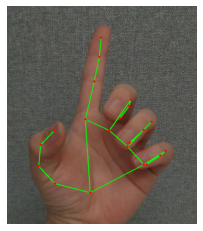

In [9]:
image_path = image_paths[0]
img = Image.open(image_path)
img_arr = np.array(img)
print(img_arr.shape)
plt.imshow(img_arr)
plt.axis('off')
plt.show()

In [10]:
js = json.load(open(json_path))

print("json keys              : ", js.keys())

print("json action info       : ",js.get('action'))

print("json actor info        : ",js.get('actor'))

print("json annotations keys  : ",js.get('annotations')[0].keys())

json keys              :  dict_keys(['action', 'actor', 'id', 'annotations'])
json action info       :  [0, '숫자 1']
json actor info        :  None
json annotations keys  :  dict_keys(['image_id', 'data'])


In [11]:
# answers = []
# for train_folder in train_folders :
#     json_path = glob(train_folder + '/*.json')[0]
#     js = json.load(open(json_path))
#     cat = js.get('action')[0]  # 수정
#     cat_name = js.get('action')[1]  # 수정
#     answers.append([train_folder.replace(data_path,''),cat, cat_name])

# answers = pd.DataFrame(answers, columns = ['train_path','answer', 'answer_name'])
# answers

In [12]:
# answers.to_csv('./answers.csv', index=False)

In [13]:
answers = pd.read_csv('./answers.csv')
answers

,train_path,answer,answer_name
0,/train/0,0,숫자 1
1,/train/1,0,숫자 1
2,/train/2,10,숫자 1
3,/train/3,10,숫자 1
4,/train/4,10,숫자 1
...,...,...,...
644,/train/644,194,빅토리
645,/train/645,195,부정(엄지손 아래로)
646,/train/646,195,부정(엄지손 아래로)
647,/train/647,195,부정(엄지손 아래로)


In [14]:
classes = pd.get_dummies(answers[['answer']], columns = ['answer']).to_numpy()

In [15]:
classes.shape

(649, 157)

In [16]:
np.random.shuffle(crop_train_folders) # 일반화 가능성 높이기

In [17]:
image_size = 224

In [18]:
# images  = []
# targets = []
# for train_folder in tqdm(crop_train_folders) :
#     image_paths = sorted(glob(train_folder + '/*.png'), key = lambda x : int(x.split('/')[-1].replace('.png','')))
#     query_path  = train_folder.replace(data_path,'')
#     target = classes[int(train_folder.split('/')[-1])] 
#     for image_path in image_paths:
#         img = image.load_img(image_path, target_size=(image_size,image_size,3))
#         img = image.img_to_array(img)
#         img = img/255
#         images.append(img)
#         targets.append(target)

In [19]:
# np.save('./crop_img_380', np.array(images))
# np.save('./crop_targets_380', np.array(targets))

In [20]:
images = np.load('./crop_img2.npy')
targets = np.load('./crop_targets2.npy')

In [21]:
X = images
print('Train X Shape : ', X.shape)

y = targets
print('Train y Shape : ', y.shape)


Train X Shape :  (5887, 224, 224, 3)
Train y Shape :  (5887, 157)


In [22]:
del images
del targets

In [23]:
! pip install -U tensorflow-addons
import tensorflow_addons as tfa

     |████████████████████████████████| 1.1 MB 9.1 MB/s 


In [24]:
!pip install --quiet vit-keras
from vit_keras import vit

In [25]:
! pip install adabelief_tf 
from adabelief_tf import AdaBeliefOptimizer


In [26]:
learning_rate = 0.001
weight_decay = 0.0001
batch_size = 32
num_epochs = 100

In [27]:
num_classes = classes.shape[1]
print(num_classes)
input_shape = (image_size, image_size, 3)

157


In [28]:
from tensorflow.python.keras.preprocessing.image import ImageDataGenerator

datagen = ImageDataGenerator(
                rotation_range = 10,
                width_shift_range=0.1,
                height_shift_range=0.1,
                # shear_range=0.1,
                # zoom_range=0.1
            )

valgen = ImageDataGenerator(
        )

In [29]:
def vit_model():
    
    model = Sequential()
    model.add(vit.vit_b16(
        image_size = image_size,
        activation = 'softmax',
        pretrained = True,
        include_top = False,
        pretrained_top = False,
        classes = num_classes))
    
    model.add(Flatten())
    model.add(BatchNormalization())
    model.add(Dense(128, activation = tfa.activations.gelu))
    model.add(BatchNormalization())
    model.add(Dense(64, activation = tfa.activations.gelu))
    model.add(BatchNormalization())
    model.add(Dense(num_classes, activation = "softmax"))


    return model

In [30]:
max_rate = 1e-3
min_rate = 1e-4
cycle = 10

In [31]:
from keras.callbacks import Callback
from keras import backend as K
import math
class CosineAnnealingScheduler(Callback):
    """Cosine annealing scheduler.
    """

    def __init__(self, n_epochs, lr_max, lr_min, n_cycle, verbose=0):
        super(CosineAnnealingScheduler, self).__init__()
        self.n_epochs = n_epochs
        self.lr_max = lr_max
        self.lr_min = lr_min
        self.n_cycle = n_cycle
        self.lrates = list()
        self.verbose = verbose
        
    def cosine_annealing(self, epoch):
        
        epochs_per_cycle = math.floor(self.n_epochs/self.n_cycle)
        cos_inner = (math.pi * (epoch % (epochs_per_cycle))) / (epochs_per_cycle)
        
        return (self.lr_max - self.lr_min)/2 * (tf.math.cos(cos_inner) + 1) + self.lr_min
     
    def plot(self, epoch):
        lr = self.cosine_annealing(epoch)
        self.lrates.append(lr)
        
    def on_epoch_begin(self, epoch, logs=None):
        if not hasattr(self.model.optimizer, 'lr'):
            raise ValueError('Optimizer must have a "lr" attribute.')
        lr = self.cosine_annealing(epoch)
        K.set_value(self.model.optimizer.lr, lr)
        if self.verbose == 0:
            print('\nEpoch %05d: CosineAnnealingScheduler setting learning '
                  'rate to %s.' % (epoch + 1, lr))
            
    def on_epoch_end(self, epoch, logs=None):
        logs = logs or {}
        logs['lr'] = K.get_value(self.model.optimizer.lr)

------------------------------------------------------------------------
Training for fold 4 ...
Please check your arguments if you have upgraded adabelief-tf from version 0.0.1.
Modifications to default arguments:
                           eps  weight_decouple    rectify
-----------------------  -----  -----------------  -------------
adabelief-tf=0.0.1       1e-08  Not supported      Not supported
>=0.1.0 (Current 0.2.1)  1e-14  supported          default: True
SGD better than Adam (e.g. CNN for Image Classification)    Adam better than SGD (e.g. Transformer, GAN)
----------------------------------------------------------  ----------------------------------------------
Recommended epsilon = 1e-7                                  Recommended epsilon = 1e-14
For a complete table of recommended hyperparameters, see
https://github.com/juntang-zhuang/Adabelief-Optimizer
You can disable the log message by setting "print_change_log = False", though it is recommended to keep as a reminder.



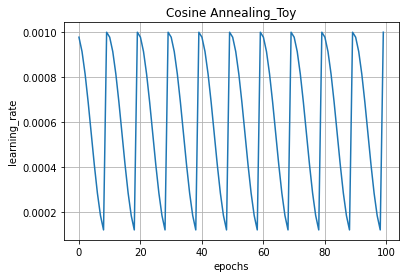

Epoch 1/100

Epoch 00001: CosineAnnealingScheduler setting learning rate to tf.Tensor(0.0009999999, shape=(), dtype=float32).
147/147 [==============================] - 191s 869ms/step - loss: 4.4627 - accuracy: 0.1263 - top-5-accuracy: 0.2743 - val_loss: 3.4159 - val_accuracy: 0.3212 - val_top-5-accuracy: 0.6678
Epoch 2/100

Epoch 00002: CosineAnnealingScheduler setting learning rate to tf.Tensor(0.0009779754, shape=(), dtype=float32).
147/147 [==============================] - 126s 854ms/step - loss: 2.8528 - accuracy: 0.5338 - top-5-accuracy: 0.8324 - val_loss: 1.5352 - val_accuracy: 0.8012 - val_top-5-accuracy: 0.9677
Epoch 3/100

Epoch 00003: CosineAnnealingScheduler setting learning rate to tf.Tensor(0.0009140576, shape=(), dtype=float32).
147/147 [==============================] - 126s 854ms/step - loss: 1.5019 - accuracy: 0.8600 - top-5-accuracy: 0.9853 - val_loss: 0.4917 - val_accuracy: 0.9567 - val_top-5-accuracy: 0.9983
Epoch 4/100

Epoch 00004: CosineAnnealingScheduler sett

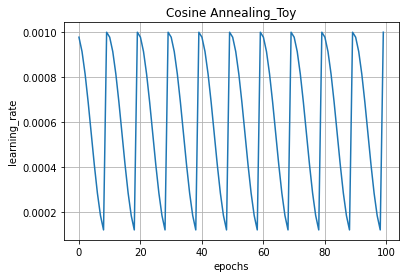

Epoch 1/100

Epoch 00001: CosineAnnealingScheduler setting learning rate to tf.Tensor(0.0009999999, shape=(), dtype=float32).
147/147 [==============================] - 173s 869ms/step - loss: 4.4796 - accuracy: 0.1082 - top-5-accuracy: 0.2702 - val_loss: 3.3664 - val_accuracy: 0.3883 - val_top-5-accuracy: 0.6907
Epoch 2/100

Epoch 00002: CosineAnnealingScheduler setting learning rate to tf.Tensor(0.0009779754, shape=(), dtype=float32).
147/147 [==============================] - 126s 852ms/step - loss: 2.7145 - accuracy: 0.5960 - top-5-accuracy: 0.8561 - val_loss: 1.3064 - val_accuracy: 0.8437 - val_top-5-accuracy: 0.9839
Epoch 3/100

Epoch 00003: CosineAnnealingScheduler setting learning rate to tf.Tensor(0.0009140576, shape=(), dtype=float32).
147/147 [==============================] - 126s 852ms/step - loss: 1.3604 - accuracy: 0.8891 - top-5-accuracy: 0.9876 - val_loss: 0.3972 - val_accuracy: 0.9643 - val_top-5-accuracy: 0.9983
Epoch 4/100

Epoch 00004: CosineAnnealingScheduler sett

In [ ]:
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from sklearn.model_selection import KFold
from sklearn.model_selection import StratifiedKFold
from tensorflow.keras.applications import EfficientNetB0


# kfold = KFold(n_splits=5, shuffle=True)
skf = StratifiedKFold(n_splits=5, random_state=42, shuffle=True)

fold_no = 1
for e , (train, val) in  enumerate(skf.split(X, np.argmax(y, axis=1))):

    if fold_no in [4, 5]:
        print('------------------------------------------------------------------------')
        print(f'Training for fold {fold_no} ...')

        # modelpath = "./vit_model/vit_aug_{epoch:02d}-{val_loss:.4f}_fold:%d.hdf5" % fold_no
        checkpoint = ModelCheckpoint('./vit_model'+f'/check{e}_vit_b16.h5',save_best_only=True)
        early_stopping_callback = EarlyStopping(monitor='val_loss', patience=7)
        
        AdaBelief = AdaBeliefOptimizer(learning_rate=1e-3, epsilon=1e-8, weight_decay=1e-2)

        train_x = X[train]
        train_y = y[train]
        valid_x = X[val]
        valid_y = y[val]

        # cosine_scheduler = CosineAnnealingScheduler(num_epochs, max_rate, min_rate, cycle)
        # optimizer = AdaBelief

        # optimizer = tfa.optimizers.AdamW(
        #     learning_rate=learning_rate, weight_decay=weight_decay
        # )


        model = vit_model()

        model.compile(
            optimizer=AdaBelief,
            loss=tf.keras.losses.CategoricalCrossentropy(),
            metrics=[
                tf.keras.metrics.CategoricalAccuracy(name="accuracy"),
                tf.keras.metrics.TopKCategoricalAccuracy(5, name="top-5-accuracy"),
            ],
        )


        cosine_scheduler = CosineAnnealingScheduler(num_epochs, max_rate, min_rate, cycle)

        for i in range(1, num_epochs + 1):
            cosine_scheduler.plot(i)

        plt.plot(cosine_scheduler.lrates)
        plt.title('Cosine Annealing_Toy')
        plt.xlabel('epochs'); plt.ylabel('learning_rate')
        plt.grid()
        plt.show()
        

        training_generator = datagen.flow(train_x, train_y, batch_size=batch_size, seed=77, shuffle=True)
        validation_generator = valgen.flow(valid_x, valid_y, batch_size=batch_size, seed=77, shuffle=True)
        history = model.fit(
            training_generator,
            shuffle=True,
            steps_per_epoch =len(train_x)//batch_size,
            epochs=num_epochs,
            validation_data=validation_generator,
            callbacks=[checkpoint, early_stopping_callback,cosine_scheduler]
        )

        del train_x
        del train_y
        del valid_x
        del valid_y

        gc.collect()
        k.clear_session()

    fold_no += 1


In [ ]:
# from tensorflow.keras.preprocessing import image
# test_images  = []
# for test_folder in tqdm(crop_test_folders) :
#     image_paths = sorted(glob(test_folder + '/*.png'), key = lambda x : int(x.split('/')[-1].replace('.png','')))
#     query_path  = test_folder.replace(data_path,'')
#     test_image = []
#     for image_path in image_paths:
#         img = image.load_img(image_path, target_size=(300,300,3))
#         img = image.img_to_array(img)
#         img = img/255
#         test_image.append(img)
#     test_images.append(test_image)

# test_images = np.array(test_images)
# print(test_images.shape)

In [ ]:
# np.save('./crop_test_images_300', np.array(test_images))

In [32]:
test_images = np.load('./crop_test_images2.npy',allow_pickle=True)
print(test_images.shape)

(217,)


In [33]:
print(np.array(test_images.shape))

[217]


In [34]:
np.array(test_images[0]).shape

(7, 224, 224, 3)

In [35]:
import time
start = time.time()  # 시작 시간 저장

sub=np.zeros((test_images.shape[0], num_classes))  

for e in range(5):

    model = vit_model()
    model.load_weights('./vit_model'+f'/checkcheck{e}_vit_b16.h5')

    predictions = []
    for test_image in tqdm(test_images, total = len(test_images)) : 
        prediction = np.mean(model.predict(np.array(test_image)), axis = 0)
        predictions.append(prediction)

    sub+=predictions

mean_sub = sub/5
mean_sub

print("time :", time.time() - start)  # 현재시각 - 시작시간 = 실행 시간

347512832/347502902 [==============================] - 6s 0us/step


100%|██████████| 217/217 [00:30<00:00,  7.07it/s]

time : 216.16228985786438


In [36]:
predictions_label = []
for i in mean_sub:

    predictions_label.append(np.argmax(i))

In [174]:
sample_submission.iloc[:,1:] = mean_sub
display(sample_submission.head())
sample_submission.to_csv('./submit/vit16_aug_kfold5.csv', index=False)

,Image_Path,Label_0,Label_1,Label_2,Label_3,Label_4,Label_5,Label_6,Label_7,Label_8,Label_9,Label_10,Label_11,Label_12,Label_13,Label_14,Label_15,Label_16,Label_17,Label_18,Label_19,Label_22,Label_23,Label_25,Label_26,Label_27,Label_28,Label_29,Label_31,Label_32,Label_34,Label_35,Label_36,Label_37,Label_39,Label_40,Label_41,Label_42,Label_43,Label_44,...,Label_142,Label_143,Label_144,Label_145,Label_146,Label_147,Label_148,Label_149,Label_150,Label_151,Label_153,Label_154,Label_155,Label_156,Label_157,Label_158,Label_159,Label_160,Label_161,Label_162,Label_163,Label_165,Label_167,Label_168,Label_169,Label_171,Label_172,Label_173,Label_174,Label_175,Label_177,Label_186,Label_188,Label_189,Label_190,Label_191,Label_192,Label_193,Label_194,Label_195
0,./test\649,0.571244,0.009073,0.000226,0.000587,0.000140,0.020332,0.021702,0.000481,0.000217,1.989884e-04,0.037494,0.001330,0.000638,0.000511,0.000111,0.001527,3.396424e-03,0.000770,0.000189,0.000110,0.001833,3.310631e-03,1.856330e-04,0.000418,0.002957,5.162877e-03,0.004431,0.000093,0.000692,0.000056,0.205367,4.571220e-04,0.000449,0.000153,0.000443,0.000100,0.000915,0.000336,0.000456,...,0.000936,0.000078,0.000268,7.457125e-04,0.000158,0.000325,0.000197,0.000811,1.901634e-04,0.000306,5.165317e-04,0.000131,0.000286,0.000251,0.000294,0.000142,0.000450,0.000356,0.000177,4.358698e-04,1.909459e-04,1.001346e-04,1.359490e-03,2.790316e-04,0.000170,0.000259,0.000142,1.291494e-04,0.000038,6.855109e-05,2.152872e-04,0.000193,0.000886,5.961840e-04,0.000502,0.000678,0.000672,0.000089,0.000345,3.372585e-04
1,./test\650,0.000208,0.000041,0.000002,0.000008,0.000040,0.000018,0.000260,0.000002,0.000005,2.168880e-05,0.996004,0.000063,0.000032,0.000118,0.000015,0.000050,6.107216e-04,0.000025,0.000005,0.000004,0.000002,2.699158e-05,2.010032e-06,0.000003,0.000011,1.115741e-04,0.000048,0.000002,0.000057,0.000002,0.000083,6.948886e-06,0.000003,0.000015,0.000007,0.000015,0.000018,0.000011,0.000014,...,0.000008,0.000003,0.000002,8.663835e-06,0.000057,0.000003,0.000018,0.000008,5.553394e-07,0.000002,5.048786e-05,0.000012,0.000001,0.000001,0.000019,0.000006,0.000019,0.000007,0.000016,1.513393e-04,5.535977e-05,4.706759e-06,5.483004e-05,1.479207e-06,0.000006,0.000023,0.000005,8.080943e-06,0.000002,7.002230e-07,1.024705e-06,0.000006,0.000003,1.901164e-05,0.000007,0.000024,0.000001,0.000001,0.000001,2.110454e-06
2,./test\651,0.000081,0.001111,0.000097,0.000029,0.000142,0.000020,0.000135,0.000215,0.000011,4.109657e-05,0.106936,0.883301,0.000627,0.000212,0.000017,0.000134,2.408002e-04,0.000561,0.000062,0.000032,0.000019,3.513047e-05,9.670248e-06,0.000004,0.000145,2.677122e-05,0.000044,0.000019,0.000040,0.000011,0.000136,8.027006e-05,0.000019,0.000072,0.000036,0.000237,0.000030,0.000010,0.000020,...,0.000004,0.000013,0.000018,1.068261e-05,0.000062,0.000187,0.000031,0.000008,4.459257e-06,0.000005,8.344161e-06,0.000013,0.000023,0.000016,0.000081,0.000010,0.000051,0.000025,0.000054,2.693007e-05,6.880726e-06,1.091131e-05,3.857202e-04,5.213182e-06,0.000010,0.000052,0.000011,5.415802e-06,0.000005,4.583636e-05,1.398973e-06,0.000028,0.000011,8.873520e-06,0.000024,0.000017,0.000004,0.000035,0.000005,6.495012e-06
3,./test\652,0.000047,0.000653,0.000058,0.000031,0.000029,0.000009,0.000033,0.000023,0.000005,3.504155e-06,0.021903,0.973667,0.000841,0.000023,0.000003,0.000102,2.251034e-05,0.000207,0.000029,0.000007,0.000027,6.966965e-06,5.998056e-06,0.000004,0.000051,4.762276e-06,0.000023,0.000003,0.000046,0.000003,0.000080,9.330202e-06,0.000010,0.000017,0.000011,0.000023,0.000006,0.000003,0.000008,...,0.000003,0.000009,0.000019,4.976501e-06,0.000005,0.000044,0.000022,0.000002,1.990905e-06,0.000002,6.218992e-07,0.000002,0.000020,0.000004,0.000017,0.000008,0.000040,0.000007,0.000007,1.510455e-05,1.186945e-06,6.833297e-07,3.232256e-04,9.044244e-07,0.000003,0.000004,0.000002,2.726611e-06,0.000004,3.598465e-05,9.971711e-07,0.000008,0.000005,2.857669e-06,0.000010,0.000003,0.000004,0.000019,0.000002,8.719489e-06
4,./test\653,0.000002,0.000

In [175]:
predictions_label

[0,
 10,
 11,
 11,
 12,
 13,
 13,
 14,
 15,
 16,
 17,
 18,
 19,
 1,
 1,
 20,
 21,
 21,
 22,
 23,
 24,
 25,
 25,
 26,
 2,
 2,
 27,
 27,
 28,
 29,
 30,
 30,
 31,
 32,
 32,
 33,
 33,
 3,
 3,
 34,
 35,
 36,
 36,
 37,
 37,
 38,
 38,
 20,
 40,
 41,
 4,
 42,
 43,
 44,
 44,
 45,
 46,
 47,
 47,
 48,
 48,
 49,
 50,
 50,
 5,
 51,
 51,
 52,
 53,
 54,
 54,
 55,
 56,
 56,
 57,
 58,
 59,
 59,
 6,
 6,
 60,
 61,
 62,
 63,
 64,
 65,
 66,
 67,
 7,
 7,
 68,
 69,
 70,
 71,
 72,
 73,
 74,
 75,
 8,
 8,
 76,
 77,
 78,
 79,
 79,
 80,
 80,
 81,
 82,
 82,
 9,
 117,
 84,
 85,
 86,
 87,
 102,
 139,
 90,
 90,
 91,
 91,
 92,
 92,
 93,
 94,
 94,
 95,
 95,
 96,
 96,
 97,
 98,
 98,
 122,
 100,
 100,
 101,
 101,
 102,
 102,
 103,
 104,
 104,
 105,
 106,
 107,
 108,
 108,
 109,
 109,
 110,
 111,
 112,
 112,
 113,
 113,
 113,
 114,
 114,
 115,
 115,
 116,
 117,
 118,
 119,
 136,
 137,
 121,
 122,
 123,
 124,
 125,
 125,
 126,
 126,
 127,
 127,
 128,
 128,
 129,
 130,
 130,
 131,
 131,
 132,
 133,
 133,
 134,
 135,
 135,
 

In [176]:
answer_num = list(answers['answer'].unique())
answer_num.sort()

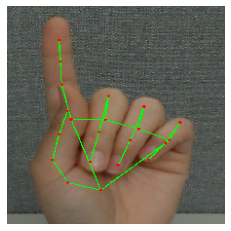

answer_num: 0
숫자 1


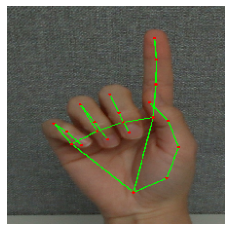

answer_num: 10
숫자 1


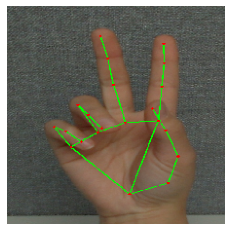

answer_num: 11
숫자 2


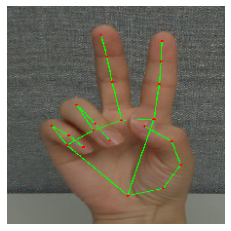

answer_num: 11
숫자 2


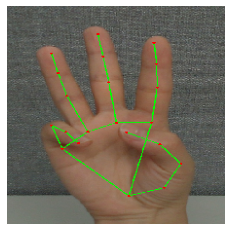

answer_num: 12
숫자 3


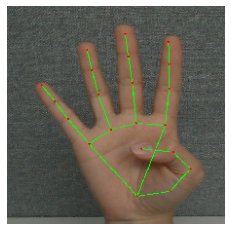

answer_num: 13
숫자 4


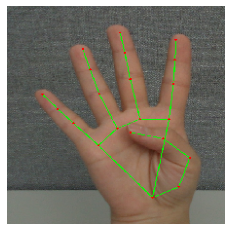

answer_num: 13
숫자 4


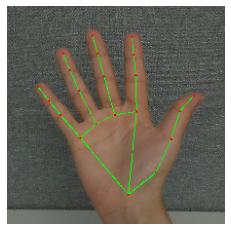

answer_num: 14
숫자 5


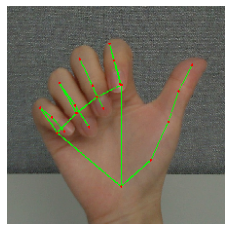

answer_num: 15
숫자 6


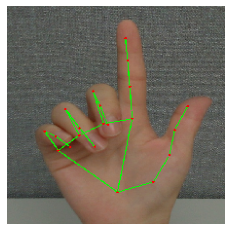

answer_num: 16
숫자 7


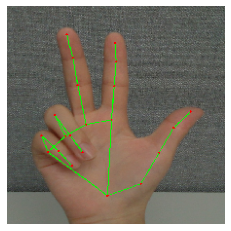

answer_num: 17
숫자 8


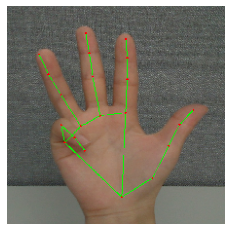

answer_num: 18
숫자 9


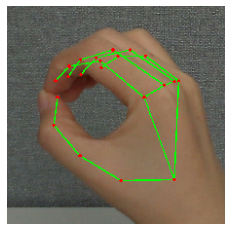

answer_num: 19
숫자 0


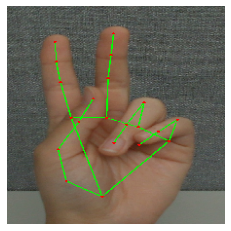

answer_num: 1
숫자 2


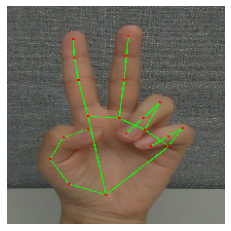

answer_num: 1
숫자 2


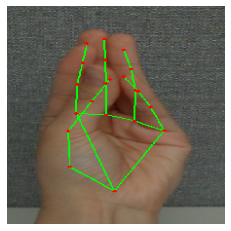

answer_num: 22
손가락 오므리기


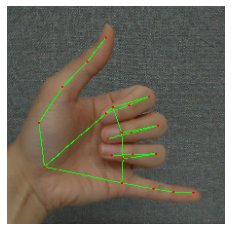

answer_num: 23
전화모양


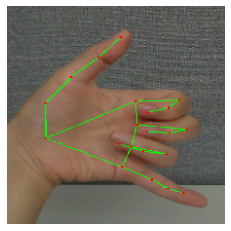

answer_num: 23
전화모양


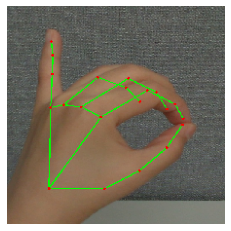

answer_num: 25
손 안경


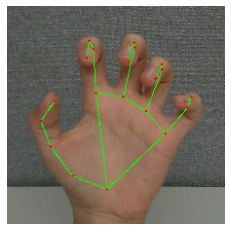

answer_num: 26
손가락 접기


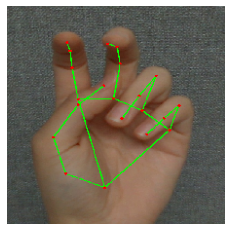

answer_num: 27
손 토끼


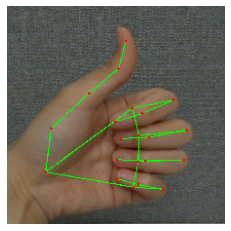

answer_num: 28
최고


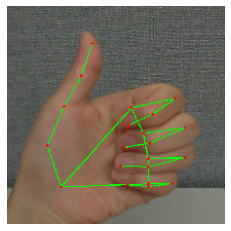

answer_num: 28
최고


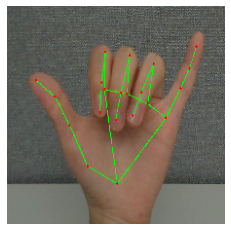

answer_num: 29
약속


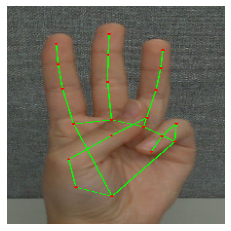

answer_num: 2
숫자 3


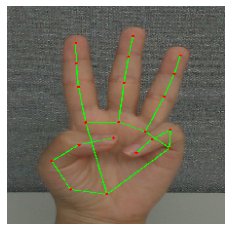

answer_num: 2
숫자 3


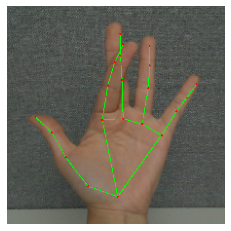

answer_num: 31
검지,중지 교차


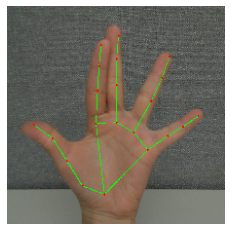

answer_num: 31
검지,중지 교차


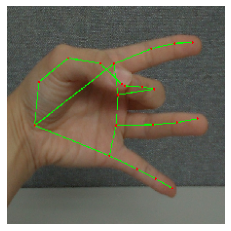

answer_num: 32
엄지,중지 붙이기


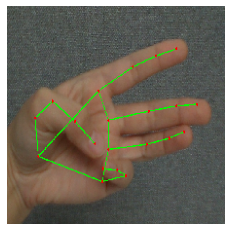

answer_num: 34
엄지,소지 붙이기


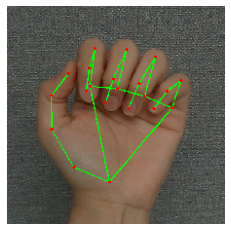

answer_num: 35
파이팅


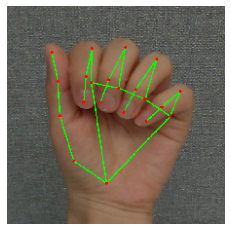

answer_num: 35
파이팅


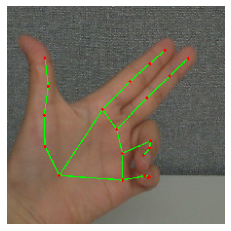

answer_num: 36
총


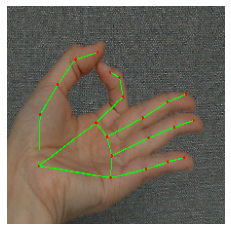

answer_num: 37
동그라미


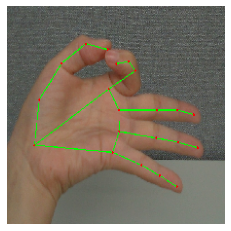

answer_num: 37
동그라미


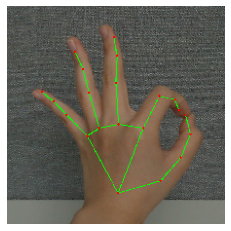

answer_num: 39
OK


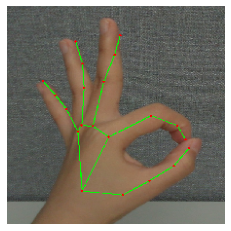

answer_num: 39
OK


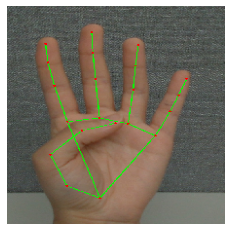

answer_num: 3
숫자 4


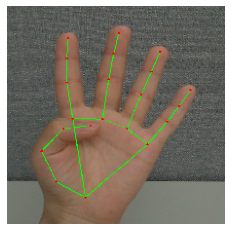

answer_num: 3
숫자 4


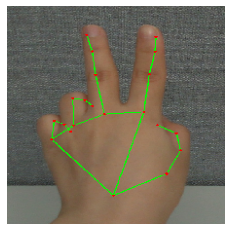

answer_num: 40
빅토리


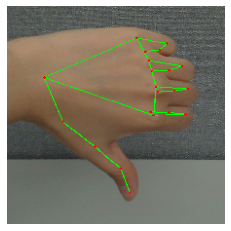

answer_num: 41
부정(엄지손 아래로)


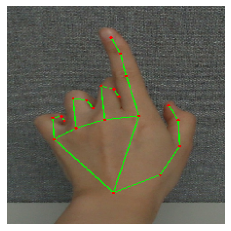

answer_num: 42
부정(검지 흔들기)


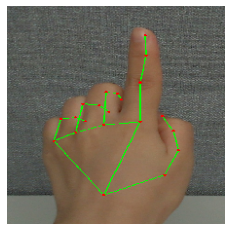

answer_num: 42
부정(검지 흔들기)


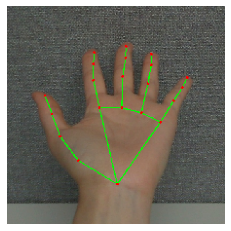

answer_num: 43
손바닥


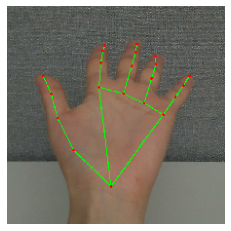

answer_num: 43
손바닥


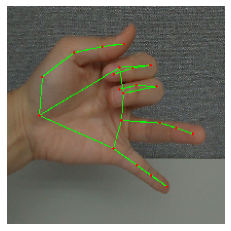

answer_num: 44
약지,소지 가위


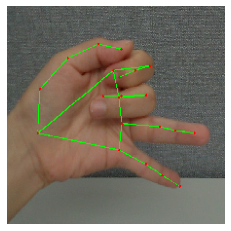

answer_num: 44
약지,소지 가위


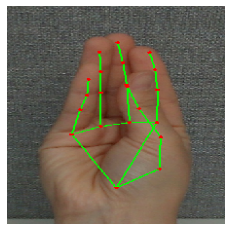

answer_num: 22
손가락 오므리기


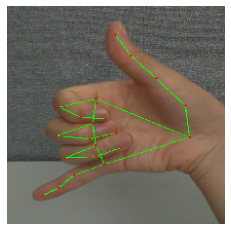

answer_num: 48
전화모양


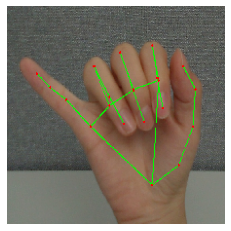

answer_num: 49
약속


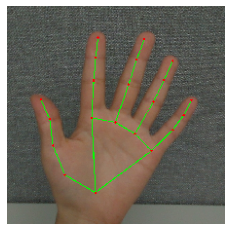

answer_num: 4
숫자 5


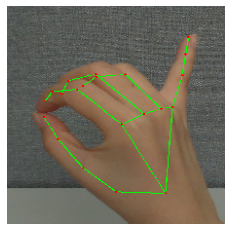

answer_num: 50
손 안경


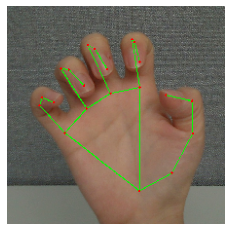

answer_num: 51
손가락 접기


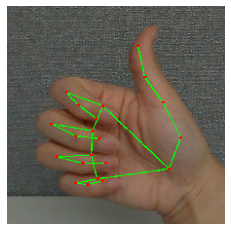

answer_num: 53
최고


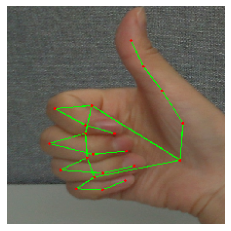

answer_num: 53
최고


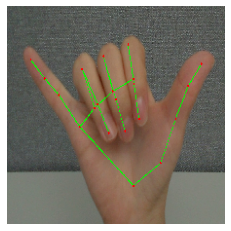

answer_num: 54
약속


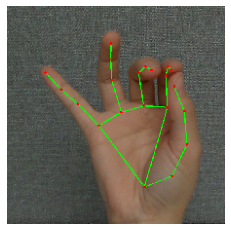

answer_num: 55
꼬집기


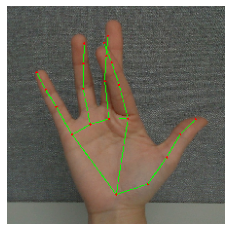

answer_num: 56
검지,중지 교차


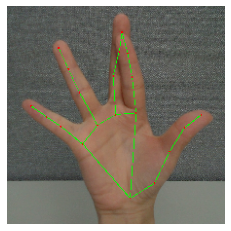

answer_num: 56
검지,중지 교차


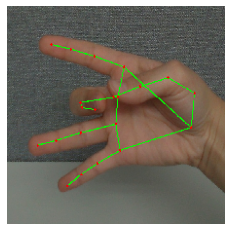

answer_num: 57
엄지,중지 붙이기


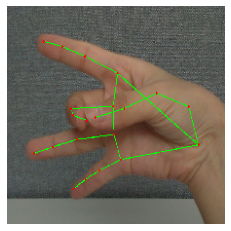

answer_num: 57
엄지,중지 붙이기


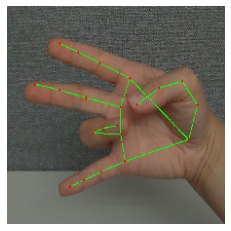

answer_num: 58
엄지,약지 붙이기


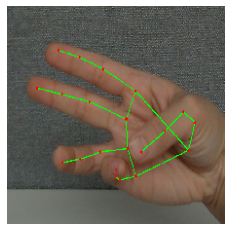

answer_num: 59
엄지,소지 붙이기


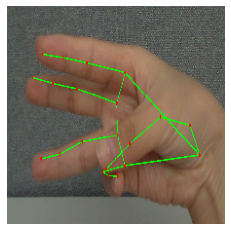

answer_num: 59
엄지,소지 붙이기


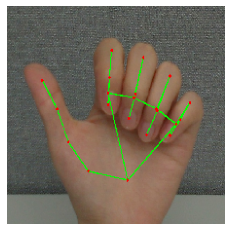

answer_num: 5
숫자 6


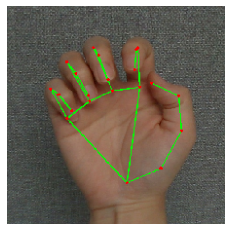

answer_num: 60
파이팅


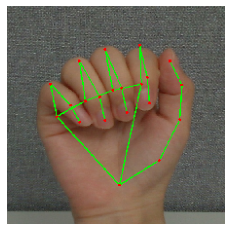

answer_num: 60
파이팅


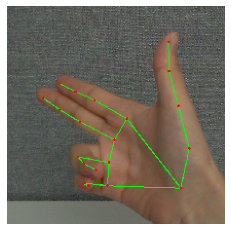

answer_num: 61
총


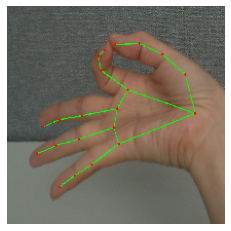

answer_num: 62
동그라미


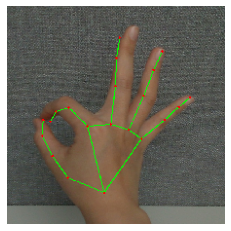

answer_num: 64
OK


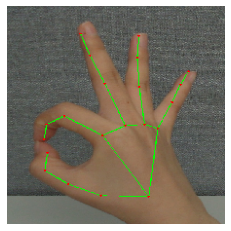

answer_num: 64
OK


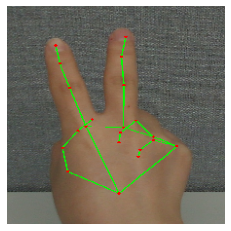

answer_num: 65
빅토리


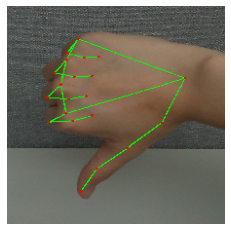

answer_num: 66
부정(엄지손 아래로)


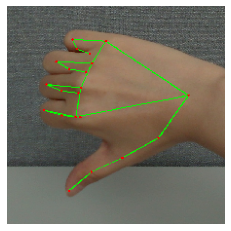

answer_num: 66
부정(엄지손 아래로)


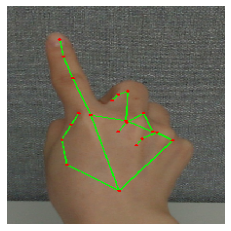

answer_num: 67
부정(검지 흔들기)


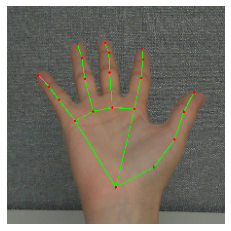

answer_num: 68
손바닥


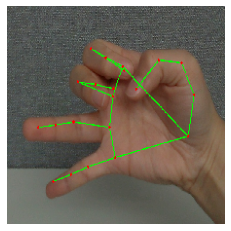

answer_num: 69
약지,소지 가위


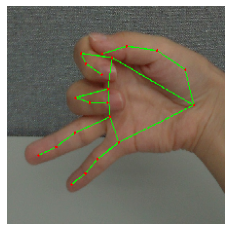

answer_num: 69
약지,소지 가위


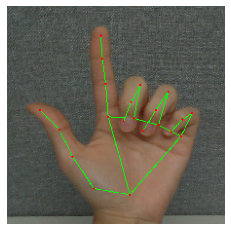

answer_num: 6
숫자 7


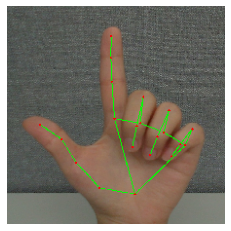

answer_num: 6
숫자 7


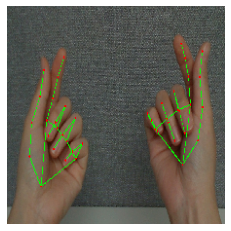

answer_num: 70
손하트


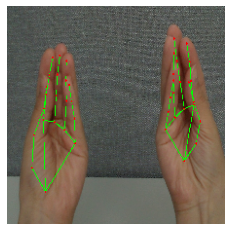

answer_num: 72
손가락 오므리기


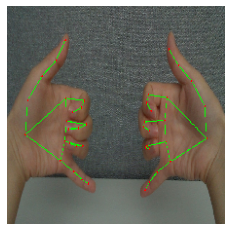

answer_num: 73
전화모양


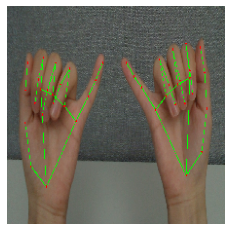

answer_num: 74
약속


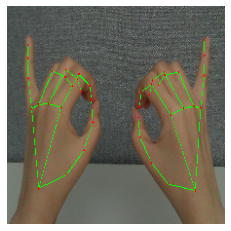

answer_num: 75
손 안경


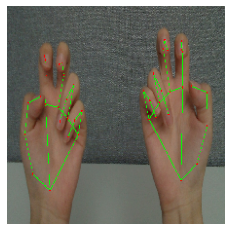

answer_num: 77
손 토끼


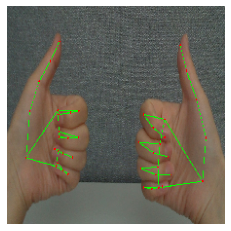

answer_num: 78
최고


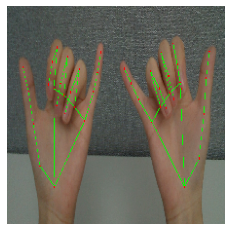

answer_num: 79
약속


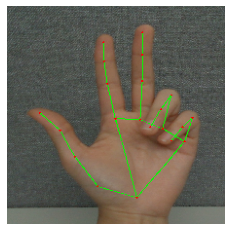

answer_num: 7
숫자 8


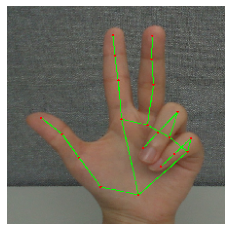

answer_num: 7
숫자 8


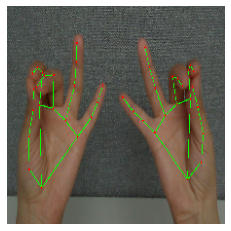

answer_num: 80
꼬집기


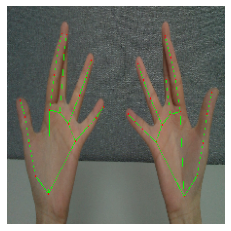

answer_num: 81
검지,중지 교차


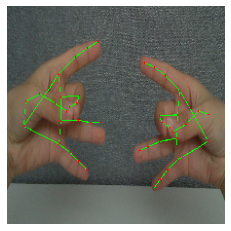

answer_num: 82
엄지,중지 붙이기


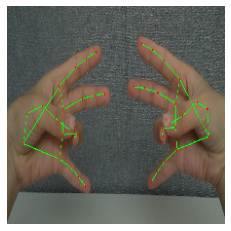

answer_num: 83
엄지,약지 붙이기


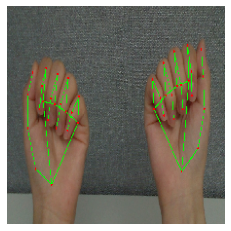

answer_num: 85
파이팅


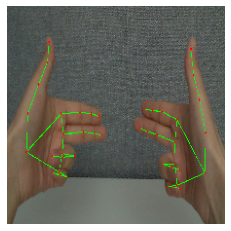

answer_num: 87
총


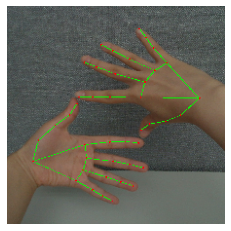

answer_num: 88
네모


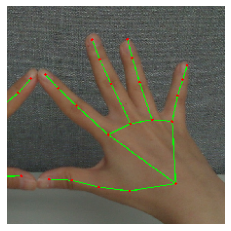

answer_num: 89
세모


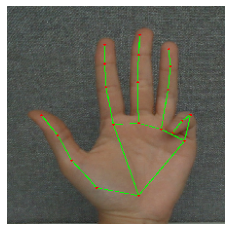

answer_num: 8
숫자 9


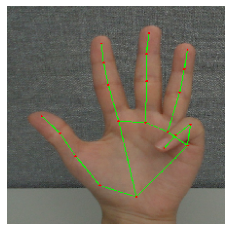

answer_num: 8
숫자 9


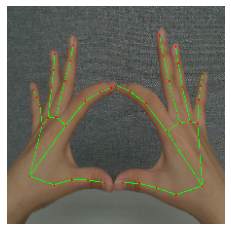

answer_num: 90
동그라미


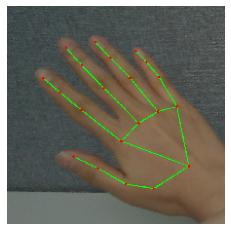

answer_num: 92
X


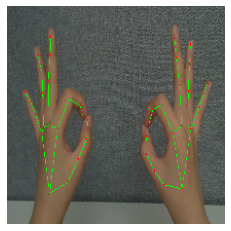

answer_num: 93
OK


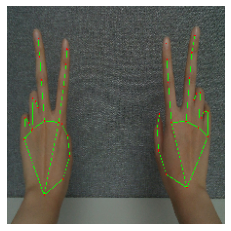

answer_num: 94
빅토리


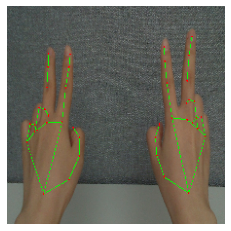

answer_num: 94
빅토리


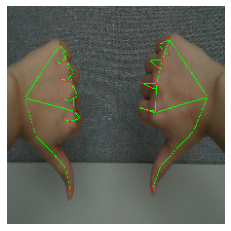

answer_num: 95
부정(엄지손 아래로)


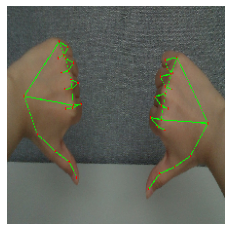

answer_num: 95
부정(엄지손 아래로)


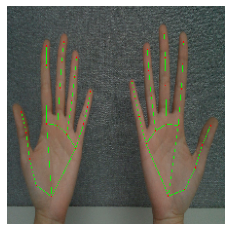

answer_num: 97
손바닥


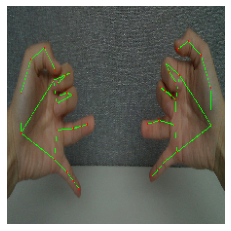

answer_num: 98
약지,소지 가위


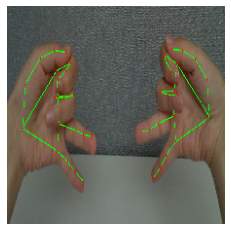

answer_num: 98
약지,소지 가위


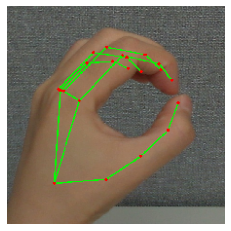

answer_num: 9
숫자 0


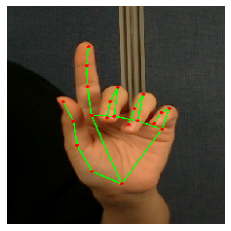

answer_num: 142
부정(검지 흔들기)


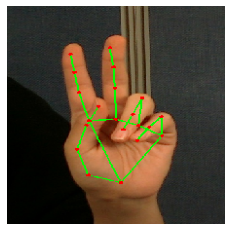

answer_num: 101
숫자2


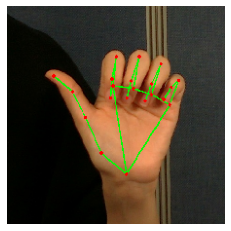

answer_num: 105
숫자6


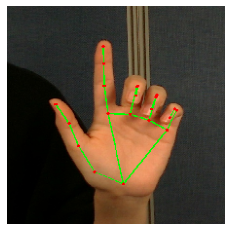

answer_num: 106
숫자7


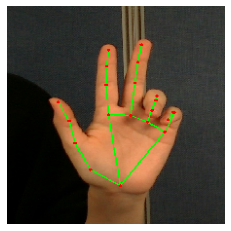

answer_num: 107
숫자8


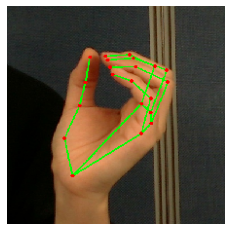

answer_num: 125
손 안경


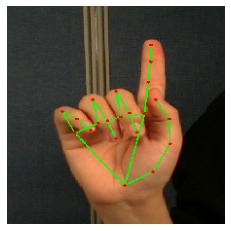

answer_num: 167
부정(검지 흔들기)


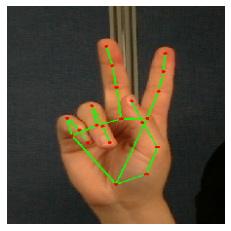

answer_num: 111
숫자2


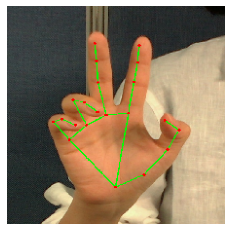

answer_num: 111
숫자2


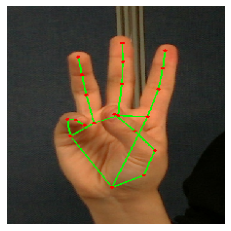

answer_num: 112
숫자3


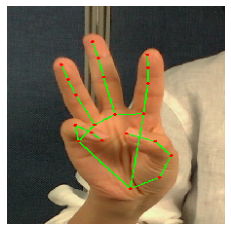

answer_num: 112
숫자3


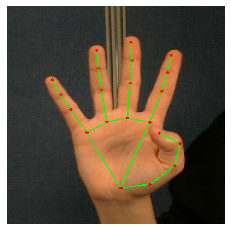

answer_num: 113
숫자4


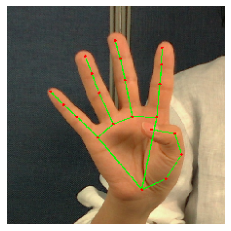

answer_num: 113
숫자4


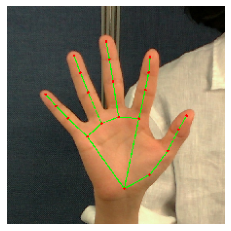

answer_num: 114
숫자5


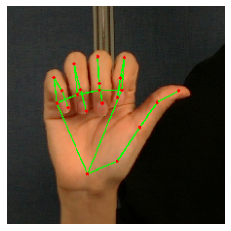

answer_num: 115
숫자6


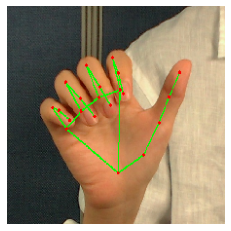

answer_num: 115
숫자6


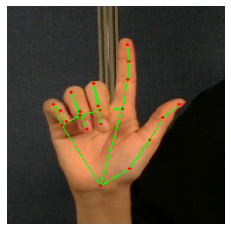

answer_num: 116
숫자7


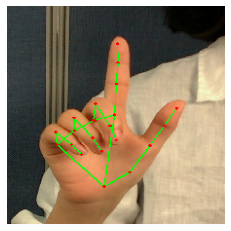

answer_num: 116
숫자7


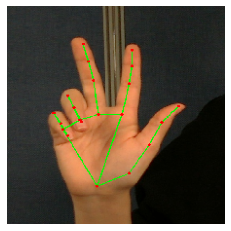

answer_num: 117
숫자8


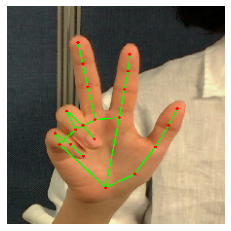

answer_num: 117
숫자8


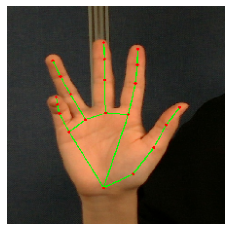

answer_num: 118
숫자9


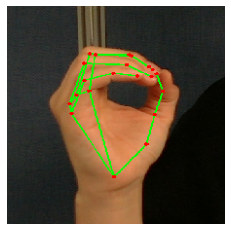

answer_num: 119
숫자0


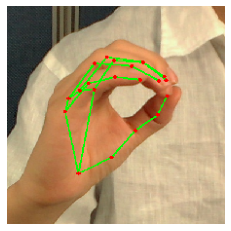

answer_num: 119
숫자0


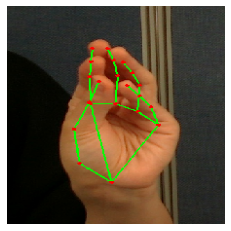

answer_num: 147
손가락 오므리기


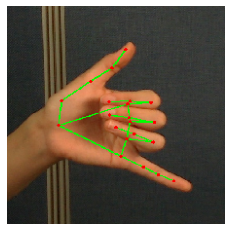

answer_num: 123
전화모양


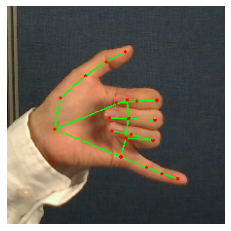

answer_num: 123
전화모양


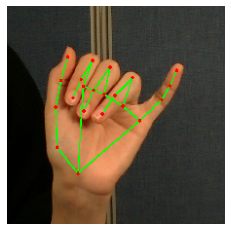

answer_num: 124
약속


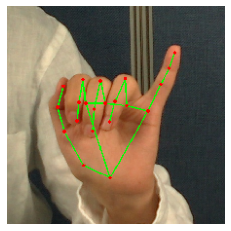

answer_num: 124
약속


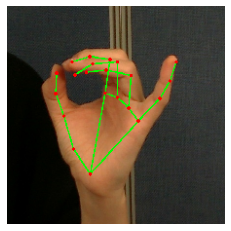

answer_num: 125
손 안경


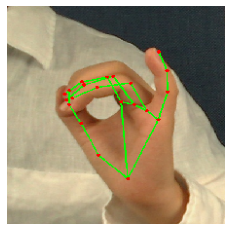

answer_num: 125
손 안경


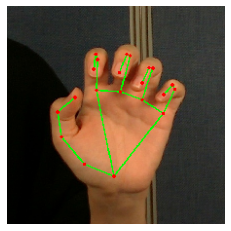

answer_num: 126
손가락 접기


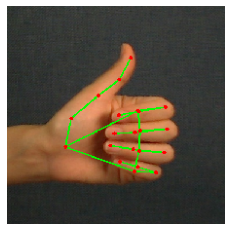

answer_num: 128
최고


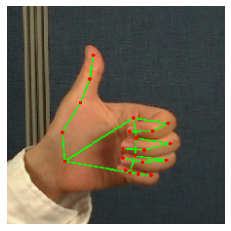

answer_num: 128
최고


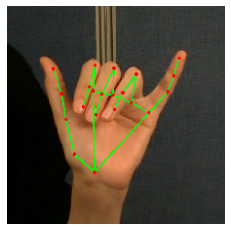

answer_num: 129
약속


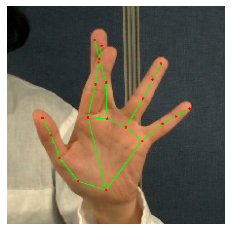

answer_num: 131
검지,중지 교차


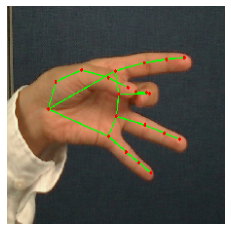

answer_num: 132
엄지,중지 붙이기


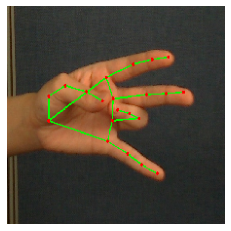

answer_num: 133
엄지,약지 붙이기


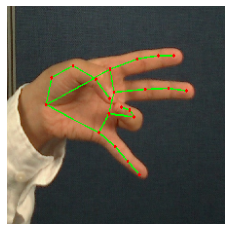

answer_num: 133
엄지,약지 붙이기


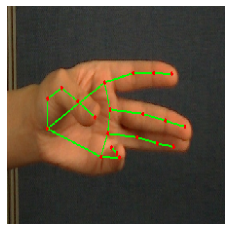

answer_num: 134
엄지,소지 붙이기


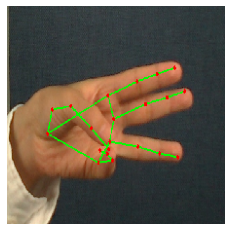

answer_num: 134
엄지,소지 붙이기


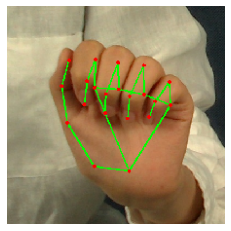

answer_num: 135
파이팅


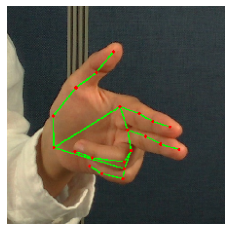

answer_num: 136
총


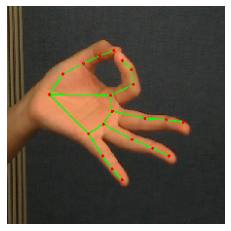

answer_num: 137
동그라미


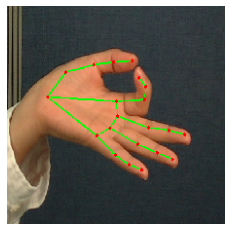

answer_num: 137
동그라미


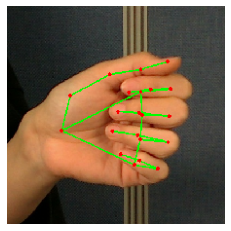

answer_num: 138
경고(주먹 내밀기)


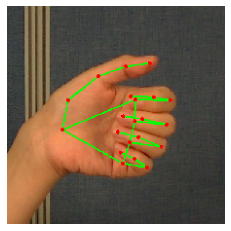

answer_num: 138
경고(주먹 내밀기)


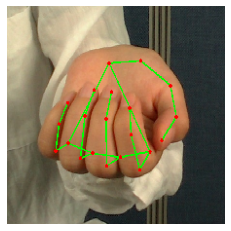

answer_num: 138
경고(주먹 내밀기)


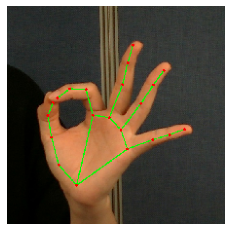

answer_num: 139
OK


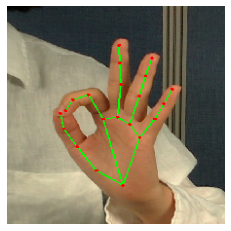

answer_num: 139
OK


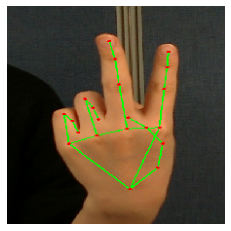

answer_num: 140
빅토리


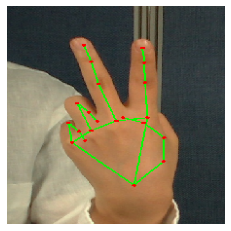

answer_num: 140
빅토리


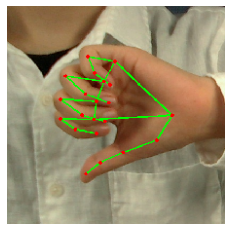

answer_num: 141
부정(엄지손 아래로)


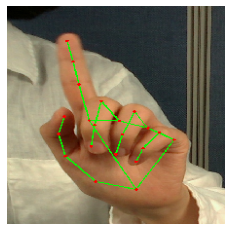

answer_num: 142
부정(검지 흔들기)


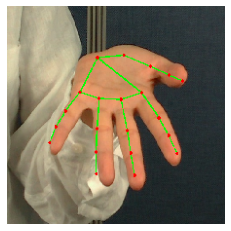

answer_num: 143
손바닥


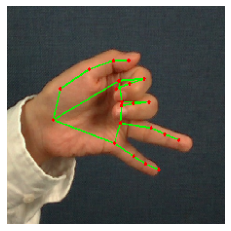

answer_num: 144
약지,소지 가위


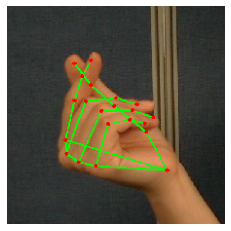

answer_num: 162
동그라미


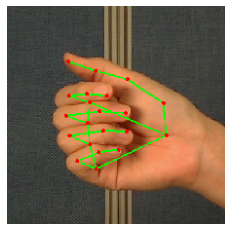

answer_num: 163
경고(주먹 내밀기)


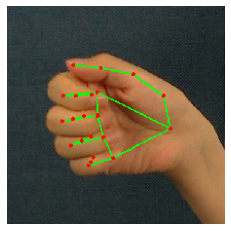

answer_num: 146
주먹쥐기


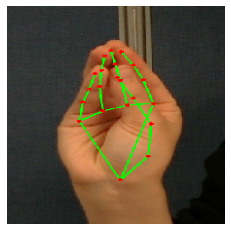

answer_num: 147
손가락 오므리기


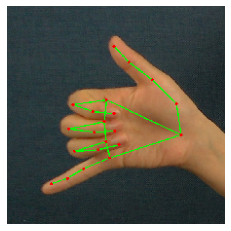

answer_num: 148
전화모양


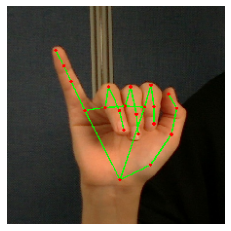

answer_num: 149
약속


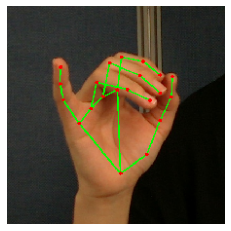

answer_num: 150
손 안경


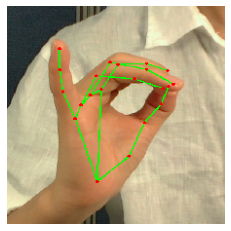

answer_num: 150
손 안경


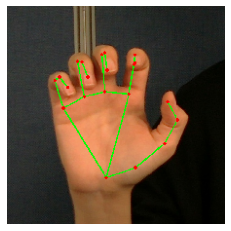

answer_num: 151
손가락 접기


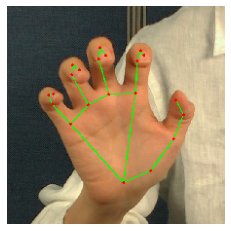

answer_num: 151
손가락 접기


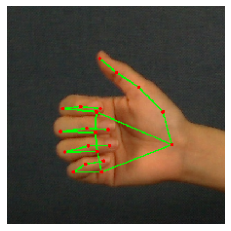

answer_num: 153
최고


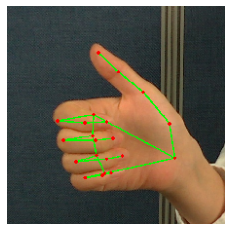

answer_num: 153
최고


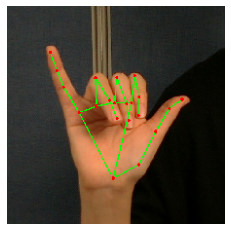

answer_num: 154
약속


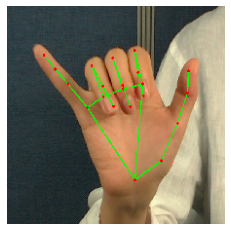

answer_num: 154
약속


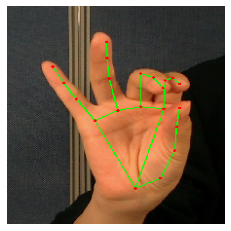

answer_num: 155
꼬집기


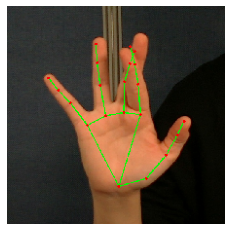

answer_num: 156
검지,중지 교차


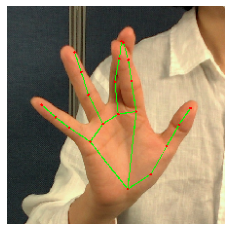

answer_num: 156
검지,중지 교차


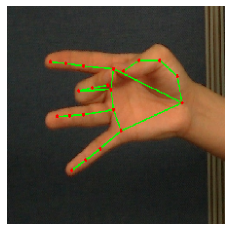

answer_num: 157
엄지,중지 붙이기


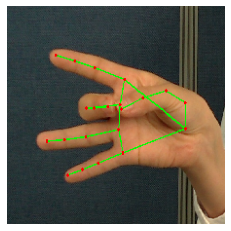

answer_num: 157
엄지,중지 붙이기


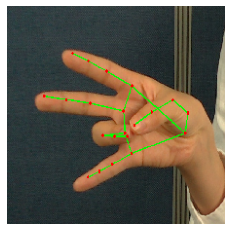

answer_num: 158
엄지,약지 붙이기


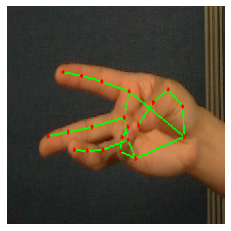

answer_num: 159
엄지,소지 붙이기


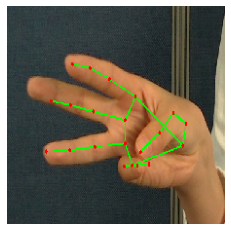

answer_num: 159
엄지,소지 붙이기


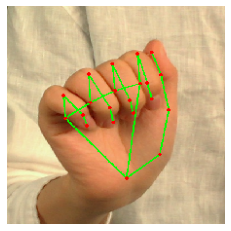

answer_num: 160
파이팅


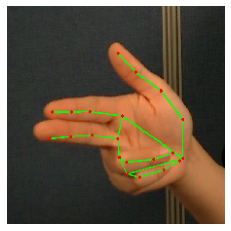

answer_num: 161
총


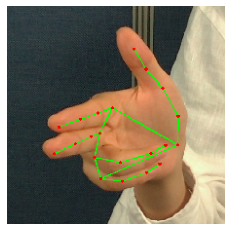

answer_num: 161
총


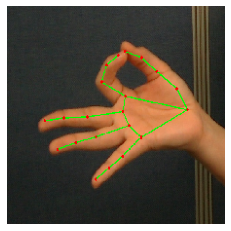

answer_num: 162
동그라미


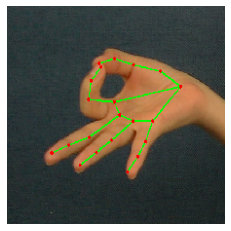

answer_num: 162
동그라미


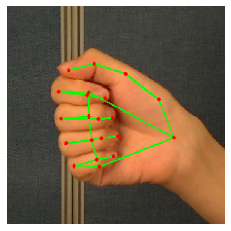

answer_num: 163
경고(주먹 내밀기)


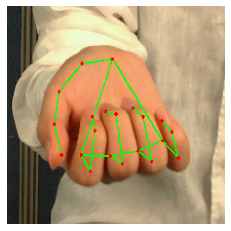

answer_num: 138
경고(주먹 내밀기)


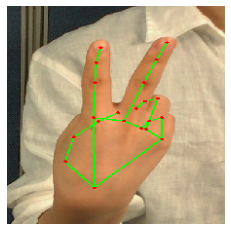

answer_num: 165
빅토리


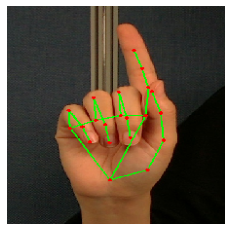

answer_num: 167
부정(검지 흔들기)


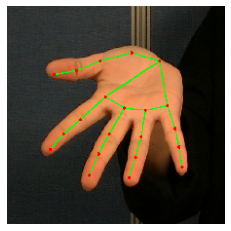

answer_num: 168
손바닥


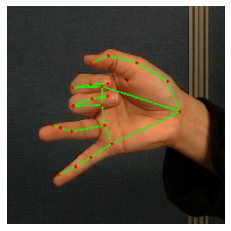

answer_num: 169
약지,소지 가위


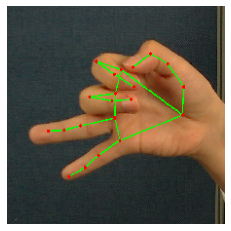

answer_num: 169
약지,소지 가위


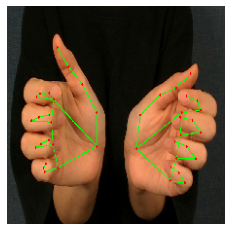

answer_num: 191
경고(주먹 내밀기)


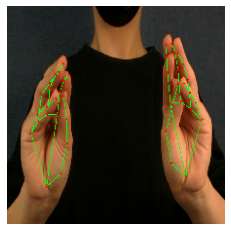

answer_num: 175
손 안경


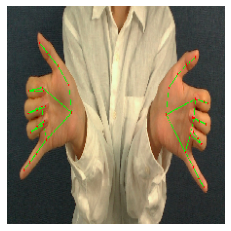

answer_num: 173
전화모양


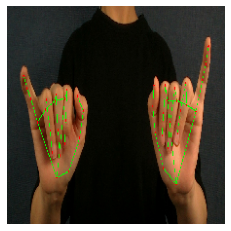

answer_num: 174
약속


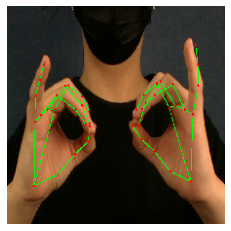

answer_num: 175
손 안경


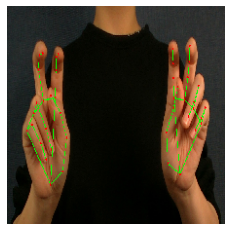

answer_num: 177
손 토끼


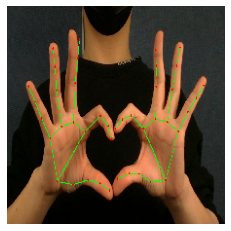

answer_num: 186
큰하트


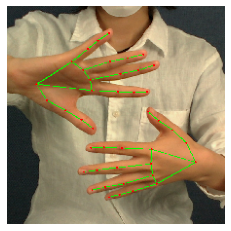

answer_num: 188
네모


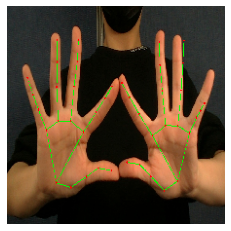

answer_num: 189
세모


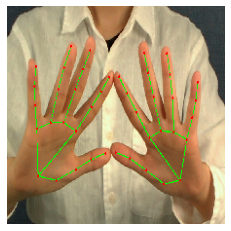

answer_num: 189
세모


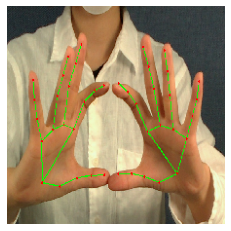

answer_num: 190
동그라미


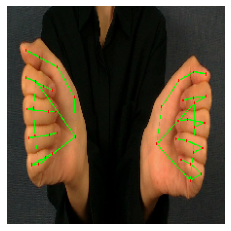

answer_num: 191
경고(주먹 내밀기)


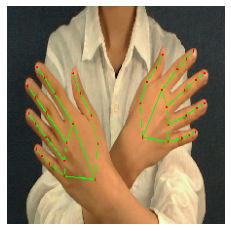

answer_num: 192
X


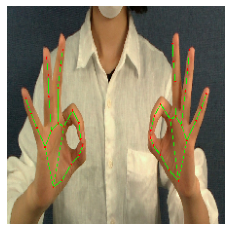

answer_num: 193
OK


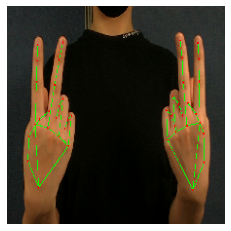

answer_num: 194
빅토리


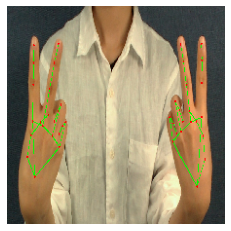

answer_num: 194
빅토리


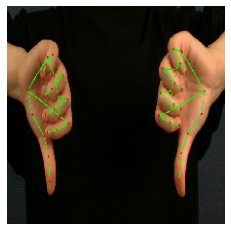

answer_num: 195
부정(엄지손 아래로)


In [177]:
for i in range(test_images.shape[0]):
    image = test_images[i][0] * 255

    plt.imshow(image.astype("uint8"))
    plt.axis("off")
    plt.show()
    
    print(f"answer_num: {answer_num[predictions_label[i]]}")
    try:
        print(list(answers['answer_name'][answers['answer']==answer_num[predictions_label[i]]])[0])
    except:
        print('없음')
        pass